In [ ]:
#! pip install https://github.com/pandas-profiling/pandas-profiling/archive/master.zip 

# About the Project

##1. Defining the question

### Specifying the question

We have a dataset that shows various attributes of a customer and how they responded to a marketing campaign. We shall attempt to use neural networks to predict whether a customer will respond positively to a campaign or not.

Data source :
https://www.kaggle.com/rodsaldanha/arketing-campaign

### Defining the metrics for success

To evaluate our model, we shall use model accuracy with the aim of achieving at least 80% accuracy. We shall compare this metrics accross decison trees, randomforests and neural networks, our main model for making the prediction.

## Importing Requied Libraries

In [ ]:
# Import Libraries
import numpy as np
import pandas as pd
pd.set_option('max_columns', None) # allows us to see all columns when data is displayed

import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler

import tensorflow as tf
from sklearn.metrics import confusion_matrix, classification_report

## Loading Dataset

In [ ]:
# Import dataset
data = pd.read_csv('marketing_campaign.csv')

In [ ]:
# Preview first five rows
data.head()

,ID,Year_Birth,Education,Marital_Status,Income,Kidhome,Teenhome,Dt_Customer,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,NumDealsPurchases,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Z_CostContact,Z_Revenue,Response
0,5524,1957,Graduation,Single,58138.0,0,0,9/4/2012,58,635,88,546,172,88,88,3,8,10,4,7,0,0,0,0,0,0,3,11,1
1,2174,1954,Graduation,Single,46344.0,1,1,3/8/2014,38,11,1,6,2,1,6,2,1,1,2,5,0,0,0,0,0,0,3,11,0
2,4141,1965,Graduation,Together,71613.0,0,0,8/21/2013,26,426,49,127,111,21,42,1,8,2,10,4,0,0,0,0,0,0,3,11,0
3,6182,1984,Graduation,Together,26646.0,1,0,2/10/2014,26,11,4,20,10,3,5,2,2,0,4,6,0,0,0,0,0,0,3,11,0
4,5324,1981,PhD,Married,58293.0,1,0,1/19/2014,94,173,43,118,46,27,15,5,5,3,6,5,0,0,0,0,0,0,3,11,0


In [ ]:
# previewing the bottom of the dataset
data.tail()

,ID,Year_Birth,Education,Marital_Status,Income,Kidhome,Teenhome,Dt_Customer,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,NumDealsPurchases,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Z_CostContact,Z_Revenue,Response
2235,10870,1967,Graduation,Married,61223.0,0,1,6/13/2013,46,709,43,182,42,118,247,2,9,3,4,5,0,0,0,0,0,0,3,11,0
2236,4001,1946,PhD,Together,64014.0,2,1,6/10/2014,56,406,0,30,0,0,8,7,8,2,5,7,0,0,0,1,0,0,3,11,0
2237,7270,1981,Graduation,Divorced,56981.0,0,0,1/25/2014,91,908,48,217,32,12,24,1,2,3,13,6,0,1,0,0,0,0,3,11,0
2238,8235,1956,Master,Together,69245.0,0,1,1/24/2014,8,428,30,214,80,30,61,2,6,5,10,3,0,0,0,0,0,0,3,11,0
2239,9405,1954,PhD,Married,52869.0,1,1,10/15/2012,40,84,3,61,2,1,21,3,3,1,4,7,0,0,0,0,0,0,3,11,1


In [ ]:
# Checking the size of the dataset
data.shape

(2240, 29)

Our dataset contains 2240 records spread across 29 columns

In [ ]:
# checking the columns
data.columns.values.tolist() #converting column names to a list

['ID',
 'Year_Birth',
 'Education',
 'Marital_Status',
 'Income',
 'Kidhome',
 'Teenhome',
 'Dt_Customer',
 'Recency',
 'MntWines',
 'MntFruits',
 'MntMeatProducts',
 'MntFishProducts',
 'MntSweetProducts',
 'MntGoldProds',
 'NumDealsPurchases',
 'NumWebPurchases',
 'NumCatalogPurchases',
 'NumStorePurchases',
 'NumWebVisitsMonth',
 'AcceptedCmp3',
 'AcceptedCmp4',
 'AcceptedCmp5',
 'AcceptedCmp1',
 'AcceptedCmp2',
 'Complain',
 'Z_CostContact',
 'Z_Revenue',
 'Response']

**Column descripion**

*   Complain - 1 if customer complained in the last 2 years
*   DtCustomer - date of customer’s enrolment with the company
*   Education - customer’s level of education
*   Marital - customer’s marital status
*   Kidhome - number of small children in customer’s household
*   Teenhome - number of teenagers in customer’s household
*   Income - customer’s yearly household income
*   MntFishProducts - amount spent on fish products in the last 2 years
*   MntMeatProducts - amount spent on meat products in the last 2 years
*   MntFruits - amount spent on fruits products in the last 2 years
*   MntSweetProducts - amount spent on sweet products in the last 2 years
*   MntWines - amount spent on wine products in the last 2 years
*   MntGoldProds - amount spent on gold products in the last 2 years
*   NumDealsPurchases - number of purchases made with discount
*   NumCatalogPurchases - number of purchases made using catalogue
*   NumStorePurchases - number of purchases made directly in stores
*   NumWebPurchases - number of purchases made through company’s web site
*   NumWebVisitsMonth - number of visits to company’s web site in the last month
*   Recency - number of days since the last purchase

*   AcceptedCmp1 - 1 if customer accepted the offer in the 1st campaign, 0 otherwise
*   AcceptedCmp2 - 1 if customer accepted the offer in the 2nd campaign, 0 otherwise
*   AcceptedCmp3 - 1 if customer accepted the offer in the 3rd campaign, 0 otherwise
*   AcceptedCmp4 - 1 if customer accepted the offer in the 4th campaign, 0 otherwise
*   AcceptedCmp5 - 1 if customer accepted the offer in the 5th campaign, 0 otherwise
*   Response (target) - 1 if customer accepted the offer in the last campaign, 0 otherwise



#### Preprocessing

In [ ]:
# Checking data types
data.dtypes

ID                       int64
Year_Birth               int64
Education               object
Marital_Status          object
Income                 float64
Kidhome                  int64
Teenhome                 int64
Dt_Customer             object
Recency                  int64
MntWines                 int64
MntFruits                int64
MntMeatProducts          int64
MntFishProducts          int64
MntSweetProducts         int64
MntGoldProds             int64
NumDealsPurchases        int64
NumWebPurchases          int64
NumCatalogPurchases      int64
NumStorePurchases        int64
NumWebVisitsMonth        int64
AcceptedCmp3             int64
AcceptedCmp4             int64
AcceptedCmp5             int64
AcceptedCmp1             int64
AcceptedCmp2             int64
Complain                 int64
Z_CostContact            int64
Z_Revenue                int64
Response                 int64
dtype: object

Our dataset contains 3 categorical variables and 26 numeric variables.

In [ ]:
# Checking for missing data
data.isna().sum()

ID                      0
Year_Birth              0
Education               0
Marital_Status          0
Income                 24
Kidhome                 0
Teenhome                0
Dt_Customer             0
Recency                 0
MntWines                0
MntFruits               0
MntMeatProducts         0
MntFishProducts         0
MntSweetProducts        0
MntGoldProds            0
NumDealsPurchases       0
NumWebPurchases         0
NumCatalogPurchases     0
NumStorePurchases       0
NumWebVisitsMonth       0
AcceptedCmp3            0
AcceptedCmp4            0
AcceptedCmp5            0
AcceptedCmp1            0
AcceptedCmp2            0
Complain                0
Z_CostContact           0
Z_Revenue               0
Response                0
dtype: int64

The income column has some missing data. We shall impute missing values in this column with the mean.

In [ ]:
# Imputing missing data in income
data['Income'] = data['Income'].fillna(data['Income'].mean())

The "ID" column seems to be a unique identifier. We shall investgate it and if it is unique identifier, we shall drop the it.

In [ ]:
# Checking ID column values
data['ID'].value_counts()

2546     1
967      1
5396     1
5394     1
7441     1
        ..
5654     1
2698     1
11133    1
3389     1
0        1
Name: ID, Length: 2240, dtype: int64

In [ ]:
# Dropping ID column
data.drop('ID', axis=1, inplace=True)

Now let's transform the date column 'Dt_Customer' into multiple variables of year, month and day.

In [ ]:
# Date encoding
data['Dt_Customer'] = pd.to_datetime(data['Dt_Customer']) # converts the values into dates
data['Year_Customer'] = data['Dt_Customer'].apply(lambda x: x.year) # creates a new column with year
data['Month_Customer'] = data['Dt_Customer'].apply(lambda x: x.month) # creates a new column with month
data['Day_Customer'] = data['Dt_Customer'].apply(lambda x: x.day) # creates a new column with day
data = data.drop('Dt_Customer', axis=1) # drops the Dt_Customer column

In [ ]:
# checking the data types
data.dtypes

Year_Birth               int64
Education               object
Marital_Status          object
Income                 float64
Kidhome                  int64
Teenhome                 int64
Recency                  int64
MntWines                 int64
MntFruits                int64
MntMeatProducts          int64
MntFishProducts          int64
MntSweetProducts         int64
MntGoldProds             int64
NumDealsPurchases        int64
NumWebPurchases          int64
NumCatalogPurchases      int64
NumStorePurchases        int64
NumWebVisitsMonth        int64
AcceptedCmp3             int64
AcceptedCmp4             int64
AcceptedCmp5             int64
AcceptedCmp1             int64
AcceptedCmp2             int64
Complain                 int64
Z_CostContact            int64
Z_Revenue                int64
Response                 int64
Year_Customer            int64
Month_Customer           int64
Day_Customer             int64
dtype: object

## Checking for consistency

In [ ]:
# checking for duplicated records
data[data.duplicated()]

,Year_Birth,Education,Marital_Status,Income,Kidhome,Teenhome,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,NumDealsPurchases,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Z_CostContact,Z_Revenue,Response,Year_Customer,Month_Customer,Day_Customer
83,1963,Master,Together,38620.0,0,0,56,112,17,44,34,22,89,1,2,5,3,3,0,0,0,0,0,0,3,11,0,2013,5,11
179,1951,2n Cycle,Married,78497.0,0,0,44,207,26,447,75,0,223,1,5,7,12,2,0,0,0,1,0,0,3,11,0,2013,12,1
281,1976,Graduation,Together,51369.0,0,1,84,297,7,79,0,11,182,2,8,2,4,8,0,0,0,0,0,0,3,11,0,2012,10,25
282,1946,Graduation,Together,37760.0,0,0,20,84,5,38,150,12,28,2,4,1,6,7,0,0,0,0,0,0,3,11,0,2012,8,31
363,1978,PhD,Married,37717.0,1,0,31,9,0,6,4,1,5,1,1,0,2,9,0,0,0,0,0,0,3,11,0,2012,11,23
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2218,1978,Graduation,Together,22775.0,1,0,40,5,1,8,0,0,1,1,1,0,2,8,0,0,0,0,0,0,3,11,0,2013,6,19
2221,1982,Master,Single,75777.0,0,0,12,712,26,538,69,13,80,1,3,6,11,1,0,1,1,0,0,0,3,11,1,2013,7,4
2225,1968,Graduation,Together,58554.0,1,1,55,368,24,68,38,0,88,6,8,2,6,7,0,0,0,0,0,0,3,11,0,2012,9,26
2234,1974,Graduation,Married,34421.0,1,0,81,3,3,7,6,2,9,1,1,0,2,7,0,0,0,0,0,0,3,11,0,2013,7,1


In [ ]:
data.columns

Index(['Year_Birth', 'Education', 'Marital_Status', 'Income', 'Kidhome',
       'Teenhome', 'Recency', 'MntWines', 'MntFruits', 'MntMeatProducts',
       'MntFishProducts', 'MntSweetProducts', 'MntGoldProds',
       'NumDealsPurchases', 'NumWebPurchases', 'NumCatalogPurchases',
       'NumStorePurchases', 'NumWebVisitsMonth', 'AcceptedCmp3',
       'AcceptedCmp4', 'AcceptedCmp5', 'AcceptedCmp1', 'AcceptedCmp2',
       'Complain', 'Z_CostContact', 'Z_Revenue', 'Response', 'Year_Customer',
       'Month_Customer', 'Day_Customer'],
      dtype='object')

## Checking for outliers

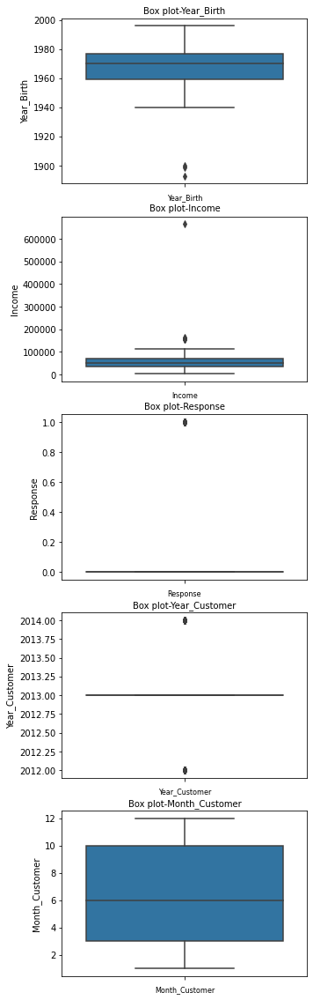

In [ ]:
columns = ['Year_Birth', 'Income', 'Response', 'Year_Customer',
       'Month_Customer']

fig, ax = plt.subplots(len(columns), figsize = (5, 20))

for i, col_val in enumerate(columns):

  sns.boxplot(y= data[col_val], ax=ax[i])
  ax[i].set_title('Box plot-{}'.format(col_val), fontsize=10)
  ax[i].set_xlabel(col_val, fontsize=8)

plt.show()

## Exploratory Data Analysis

In [ ]:
import pandas_profiling as pp

from pandas_profiling import ProfileReport
ProfileReport(data, title = "Marketing data report")

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
# statistical summary
data.describe()

,Year_Birth,Income,Kidhome,Teenhome,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,NumDealsPurchases,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Z_CostContact,Z_Revenue,Response,Year_Customer,Month_Customer,Day_Customer
count,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.0,2240.0,2240.000000,2240.000000,2240.000000,2240.000000
mean,1968.805804,52247.251354,0.444196,0.506250,49.109375,303.935714,26.302232,166.950000,37.525446,27.062946,44.021875,2.325000,4.084821,2.662054,5.790179,5.316518,0.072768,0.074554,0.072768,0.064286,0.013393,0.009375,3.0,11.0,0.149107,2013.028125,6.467411,15.638393
std,11.984069,25037.797168,0.538398,0.544538,28.962453,336.597393,39.773434,225.715373,54.628979,41.280498,52.167439,1.932238,2.778714,2.923101,3.250958,2.426645,0.259813,0.262728,0.259813,0.245316,0.114976,0.096391,0.0,0.0,0.356274,0.684554,3.486695,8.790680
min,1893.000000,1730.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,3.0,11.0,0.000000,2012.000000,1.000000,1.000000
25%,1959.000000,35538.750000,0.000000,0.000000,24.000000,23.750000,1.000000,16.000000,3.000000,1.000000,9.000000,1.000000,2.000000,0.000000,3.000000,3.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,3.0,11.0,0.000000,2013.000000,3.000000,8.000000
50%,1970.000000,51741.500000,0.000000,0.000000,49.000000,173.500000,8.000000,67.000000,12.000000,8.000000,24.000000,2.000000,4.000000,2.000000,5.000000,6.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,3.0,11.0,0.000000,2013.000000,6.000000,16.000000
75%,1977.000000,68289.750000,1.000000,1.000000,74.000000,504.250000,33.000000,232.000000,50.000000,33.000000,56.000000,3.000000,6.000000,4.000000,8.000000,7.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,3.0,11.0,0.000000,2013.000000,10.000000,23.000000
max,1996.000000,666666.000000,2.000000,2.000000,99.000000,1493.000000,199.000000,1725.000000,259.000000,263.000000,362.000000,15.000000,27.000000,28.000000,13.000000,20.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,3.0,11.0,1.000000,2014.000000,12.000000,31.000000


####Median

In [ ]:
for column in columns:
  print(column +':' + str(data[column].median()))

Year_Birth:1970.0
Income:51741.5
Response:0.0
Year_Customer:2013.0
Month_Customer:6.0


####Mode

In [ ]:
for column in columns:
  print(column +':' + str(data[column].mode()))

Year_Birth:0    1976
dtype: int64
Income:0    52247.251354
dtype: float64
Response:0    0
dtype: int64
Year_Customer:0    2013
dtype: int64
Month_Customer:0    8
dtype: int64


In [ ]:
data.columns

Index(['Year_Birth', 'Education', 'Marital_Status', 'Income', 'Kidhome',
       'Teenhome', 'Recency', 'MntWines', 'MntFruits', 'MntMeatProducts',
       'MntFishProducts', 'MntSweetProducts', 'MntGoldProds',
       'NumDealsPurchases', 'NumWebPurchases', 'NumCatalogPurchases',
       'NumStorePurchases', 'NumWebVisitsMonth', 'AcceptedCmp3',
       'AcceptedCmp4', 'AcceptedCmp5', 'AcceptedCmp1', 'AcceptedCmp2',
       'Complain', 'Z_CostContact', 'Z_Revenue', 'Response', 'Year_Customer',
       'Month_Customer', 'Day_Customer'],
      dtype='object')

## Bivariate Analysis

/usr/local/lib/python3.7/dist-packages/seaborn/categorical.py:3775: UserWarning: catplot is a figure-level function and does not accept target axes. You may wish to try countplot
  warnings.warn(msg, UserWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/categorical.py:3775: UserWarning: catplot is a figure-level function and does not accept target axes. You may wish to try countplot
  warnings.warn(msg, UserWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/categorical.py:3775: UserWarning: catplot is a figure-level function and does not accept target axes. You may wish to try countplot
  warnings.warn(msg, UserWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/categorical.py:3775: UserWarning: catplot is a figure-level function and does not accept target axes. You may wish to try countplot
  warnings.warn(msg, UserWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/categorical.py:3775: UserWarning: catplot is a figure-level function and does not accept target axes.

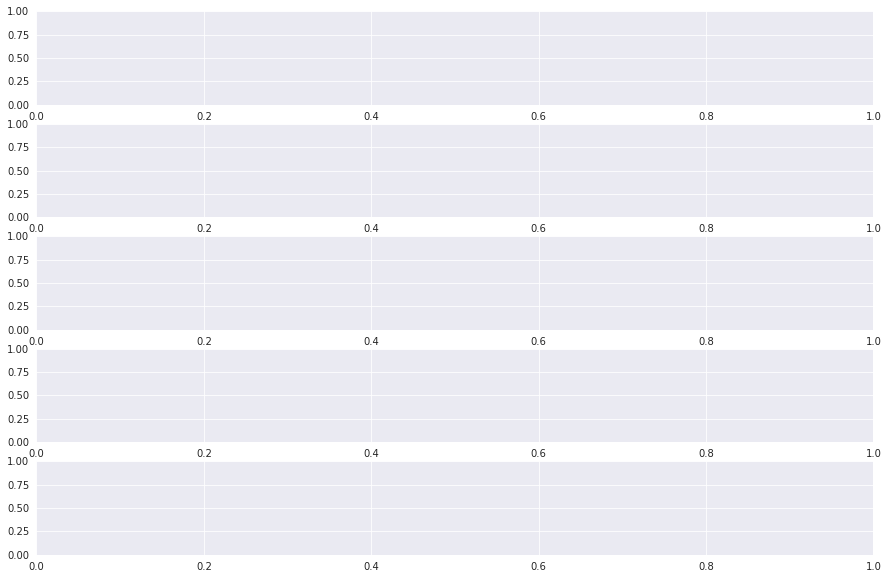

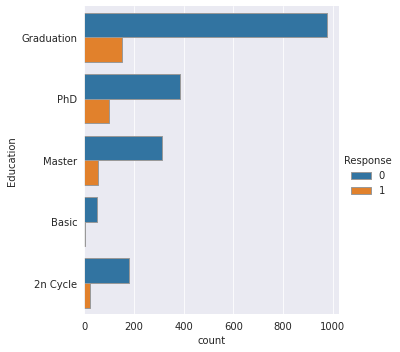

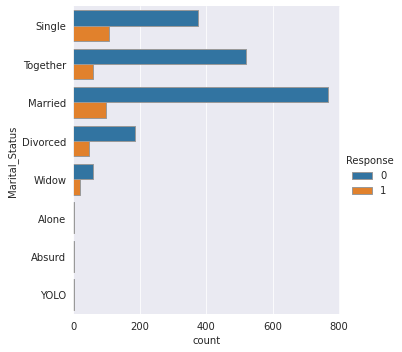

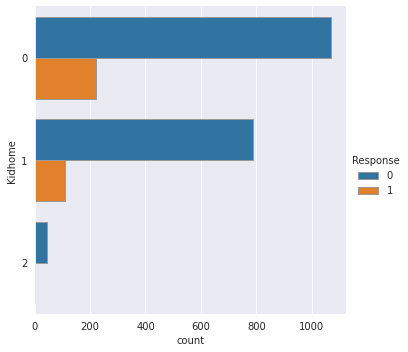

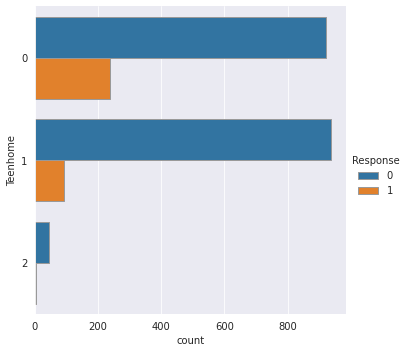

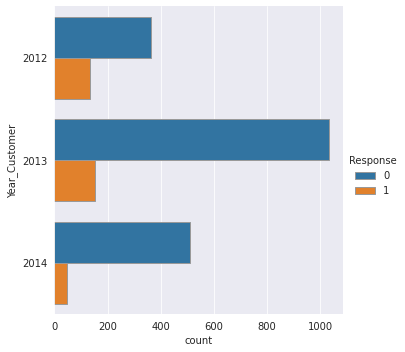

In [ ]:
# plotting cat plots
sns.set_style('darkgrid')

categorical_columns = ['Education', 'Marital_Status', 'Kidhome',
       'Teenhome','Year_Customer' ]          


fig, axes = plt.subplots(len(categorical_columns), figsize=(15, 10))
# we will set the hue to be the status column as this is our target variable
for var, subplot in zip(categorical_columns, axes.flatten()):
  sns.catplot(y=var, kind="count", hue="Response", edgecolor=".6", data=data, ax=subplot);


Next we need to transform the categorical variables into a format that the ML model will understand. We shall do this using one hot encoding.

In [ ]:
# Defining a function to encode the categorical columns

def onehotencoder(df, column):
    df = df.copy()
    dummies = pd.get_dummies(df[column], prefix=column)
    df = pd.concat([df, dummies], axis=1)
    df = df.drop(column, axis=1)
    return df

categoricals = ['Education', 'Marital_Status']

for col in categoricals:
    data = onehotencoder(data, column=col)

In [ ]:
# Defining inputs(X) and target(y) variables

y = data['Response']
X = data.drop('Response', axis=1)

In [ ]:
# Splitting data into training and testing data

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=1)

In [ ]:
X_train.head(5)

,Year_Birth,Income,Kidhome,Teenhome,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,NumDealsPurchases,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Z_CostContact,Z_Revenue,Year_Customer,Month_Customer,Day_Customer,Education_2n Cycle,Education_Basic,Education_Graduation,Education_Master,Education_PhD,Marital_Status_Absurd,Marital_Status_Alone,Marital_Status_Divorced,Marital_Status_Married,Marital_Status_Single,Marital_Status_Together,Marital_Status_Widow,Marital_Status_YOLO
1747,1946,66835.0,0,0,21,620,26,195,34,17,141,1,6,4,13,2,0,0,0,0,0,0,3,11,2013,9,28,0,0,0,1,0,0,0,0,1,0,0,0,0
115,1962,50785.0,1,1,27,64,1,21,0,1,27,2,2,1,3,6,0,0,0,0,0,0,3,11,2013,9,10,0,0,1,0,0,0,0,0,0,1,0,0,0
1739,1971,42403.0,1,0,18,22,1,11,0,5,3,1,1,0,3,8,0,0,0,0,0,0,3,11,2013,12,11,0,0,0,0,1,0,0,0,1,0,0,0,0
336,1968,75693.0,0,0,10,797,153,293,72,97,30,1,11,4,6,4,0,1,1,1,0,0,3,11,2012,12,6,0,0,1,0,0,0,0,1,0,0,0,0,0
2031,1955,67225.0,0,1,4,315,35,322,46,7,143,3,7,2,11,5,0,0,0,0,0,0,3,11,2013,11,26,0,0,1,0,0,0,0,0,1,0,0,0,0


## Feature Scaling

Since neutral networks are sensivtive to imbalanced data and uses weights to optimize the model, we shall scale the data in order to achieve data balance.

In [ ]:
# Define our scaler object
scaler =StandardScaler()
 
# Fit training and test inputs
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)

## Modelling

### **Baseline Model - Decision Tree**

In [ ]:
# imports for ensemble methods
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.svm import SVC,LinearSVC
from sklearn.preprocessing import MinMaxScaler
from sklearn import metrics
from sklearn.metrics import classification_report,confusion_matrix, accuracy_score, roc_auc_score, f1_score

In [ ]:
# Creating table to store the results 
models ={'Model':['Decision Tree', 'Random Forest'],
         'Accuracy':[0,0],
         'f1_score':[0,0]}

df_results = pd.DataFrame(models,columns=['Model','Accuracy','f1_score'])

def model_results(model_type, y_test_data, y_pred_data):
  index_val = df_results[df_results['Model']==model_type].index

  df_results.loc[index_val,'Accuracy']= accuracy_score(y_test_data, y_pred_data)
  df_results.loc[index_val,'f1_score']= f1_score(y_test_data, y_pred_data)
  
  return df_results

In [ ]:
# we will first instatiate the model
tree = DecisionTreeClassifier()
# tree = DecisionTreeClassifier(max_depth=5, min_samples_split = 20)

# train it with our training set
tree = tree.fit(X_train, y_train)

# predict based on the model we've created
y_pred = tree.predict(X_test)

# Model Accuracy, how often is the classifier correct?
model_results('Decision Tree',y_test, y_pred)

,Model,Accuracy,f1_score
0,Decision Tree,0.822917,0.430622
1,Random Forest,0.000000,0.000000


### **Alternate Baseline Model - RandomForest**

In [ ]:
# To obtain a deterministic behavior during fitting, we will fix the random state to 60
# We will alter the parameter n_estimators to see the effect this parameter has on our model
#we will set min_samples_split and max_depth as we don't want an over-complex tree.

forest = RandomForestClassifier(n_estimators = 100, random_state=60, min_samples_split = 20, max_depth=5)
forest = forest.fit(X_train, y_train)

# Predict based on the model we've trained
y_pred = forest.predict(X_test)
# printing the metrics 
model_results('Random Forest',y_test, y_pred)

,Model,Accuracy,f1_score
0,Decision Tree,0.822917,0.430622
1,Random Forest,0.855655,0.236220


### **The Model - Neural Networks**

We shall compare the model results using different optimizers in order to see which optimizer gives the best results. These are, Adam, AdaGrad, SGD & RMSPROP.

In [ ]:
# Creating table to store the results from different optimizers
optimizers ={'Optimizer':['Adam', 'AdaGrad', 'SGD', 'RMSPROP'],
         'Loss':[0,0,0,0],
         'Accuracy':[0,0,0,0],
         'AUC': [0,0,0,0]}

df_results = pd.DataFrame(optimizers,columns=['Optimizer','Loss','Accuracy', 'AUC'])

def optimizer_results(optimizer, X_test, y_test):
  index_val = df_results[df_results['Optimizer']==optimizer].index

  df_results.loc[index_val,'Loss']= evaluation[0]
  df_results.loc[index_val,'Accuracy']= evaluation[1]
  df_results.loc[index_val,'AUC']= evaluation[2]


  return df_results

#### ***Using Adam Optimizer***

In [ ]:
inputs = tf.keras.Input(shape=(X_train.shape[1])) 
x = tf.keras.layers.Dense(128, activation='relu')(inputs) 
x = tf.keras.layers.Dense(128, activation='relu')(x)
outputs = tf.keras.layers.Dense(1, activation='sigmoid')(x)

model = tf.keras.Model(inputs=inputs, outputs=outputs)


model.compile(
    optimizer='adam',
    loss='binary_crossentropy',
    metrics=[
        'accuracy',
        tf.keras.metrics.AUC(name='auc')
    ]
)

history = model.fit(
    X_train,
    y_train,
    validation_split=0.2,
    batch_size=32,
    epochs=50,
    callbacks=[
        tf.keras.callbacks.EarlyStopping(
            monitor='val_loss',
            patience=3,
            restore_best_weights=True
        )
    ]
)

Epoch 1/50
40/40 [==============================] - 2s 11ms/step - loss: 0.4459 - accuracy: 0.8325 - auc: 0.5516 - val_loss: 0.3621 - val_accuracy: 0.8822 - val_auc: 0.7911
Epoch 2/50
40/40 [==============================] - 0s 3ms/step - loss: 0.3018 - accuracy: 0.8796 - auc: 0.8439 - val_loss: 0.2938 - val_accuracy: 0.8822 - val_auc: 0.8735
Epoch 3/50
40/40 [==============================] - 0s 3ms/step - loss: 0.2494 - accuracy: 0.8971 - auc: 0.9107 - val_loss: 0.2749 - val_accuracy: 0.8854 - val_auc: 0.8937
Epoch 4/50
40/40 [==============================] - 0s 4ms/step - loss: 0.2275 - accuracy: 0.9075 - auc: 0.9222 - val_loss: 0.2623 - val_accuracy: 0.9013 - val_auc: 0.9064
Epoch 5/50
40/40 [==============================] - 0s 3ms/step - loss: 0.2100 - accuracy: 0.9155 - auc: 0.9366 - val_loss: 0.2859 - val_accuracy: 0.8822 - val_auc: 0.9014
Epoch 6/50
40/40 [==============================] - 0s 3ms/step - loss: 0.1924 - accuracy: 0.9234 - auc: 0.9482 - val_loss: 0.2637 - val_ac

**Model Evaluation**

We shall evaluate the model's performance

In [ ]:
evaluation = model.evaluate(X_test, y_test, verbose=0)
optimizer_results('Adam', X_test, y_test)

,Optimizer,Loss,Accuracy,AUC
0,Adam,0.271121,0.888393,0.901809
1,AdaGrad,0.000000,0.000000,0.000000
2,SGD,0.000000,0.000000,0.000000
3,RMSPROP,0.000000,0.000000,0.000000


Because our prediction should be binary we need to convert the predicted outputs into binary form by converting them into an array ones and zeros. Any value that is equal to or greater than 0.5 will be 1 and if less that 0.5 it will be 0.

In [ ]:
# Predict some values
y_pred = model.predict(X_test)

y_pred = np.array(y_pred >= 0.5, dtype=np.int)

Classification Report:
----------------------
               precision    recall  f1-score   support

     FAILURE       0.90      0.98      0.94       564
     SUCCESS       0.77      0.44      0.56       108

    accuracy                           0.89       672
   macro avg       0.84      0.71      0.75       672
weighted avg       0.88      0.89      0.88       672



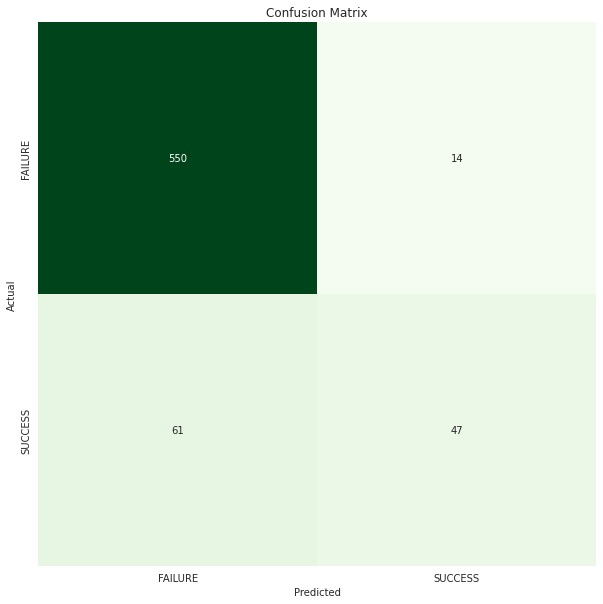

In [ ]:
# Confusion Matrix & Classification Report

cm = confusion_matrix(y_test, y_pred)
clr = classification_report(y_test, y_pred, target_names=["FAILURE", "SUCCESS"])

plt.figure(figsize=(10, 10))
sns.heatmap(cm, annot=True, fmt='g', vmin=0, cmap='Greens', cbar=False)
plt.xticks(ticks=np.arange(2) + 0.5, labels=["FAILURE", "SUCCESS"])
plt.yticks(ticks=np.arange(2) + 0.5, labels=["FAILURE", "SUCCESS"])
plt.xlabel("Predicted")
plt.ylabel("Actual")
plt.title("Confusion Matrix")
plt.show()

print("Classification Report:\n----------------------\n", clr)

#### ***Using Adagrad Optimizer***

In [ ]:
inputs = tf.keras.Input(shape=(X_train.shape[1])) 
x = tf.keras.layers.Dense(128, activation='relu')(inputs) 
x = tf.keras.layers.Dense(128, activation='relu')(x)
outputs = tf.keras.layers.Dense(1, activation='sigmoid')(x)

model = tf.keras.Model(inputs=inputs, outputs=outputs)


model.compile(
    optimizer='adagrad',
    loss='binary_crossentropy',
    metrics=[
        'accuracy',
        tf.keras.metrics.AUC(name='auc')
    ]
)

history = model.fit(
    X_train,
    y_train,
    validation_split=0.2,
    batch_size=32,
    epochs=50,
    callbacks=[
        tf.keras.callbacks.EarlyStopping(
            monitor='val_loss',
            patience=3,
            restore_best_weights=True
        )
    ]
)

Epoch 1/50
40/40 [==============================] - 1s 10ms/step - loss: 0.5539 - accuracy: 0.8325 - auc: 0.4443 - val_loss: 0.5518 - val_accuracy: 0.8471 - val_auc: 0.3570
Epoch 2/50
40/40 [==============================] - 0s 3ms/step - loss: 0.5081 - accuracy: 0.8565 - auc: 0.4594 - val_loss: 0.5235 - val_accuracy: 0.8503 - val_auc: 0.3729
Epoch 3/50
40/40 [==============================] - 0s 3ms/step - loss: 0.4799 - accuracy: 0.8573 - auc: 0.4796 - val_loss: 0.5039 - val_accuracy: 0.8503 - val_auc: 0.3994
Epoch 4/50
40/40 [==============================] - 0s 3ms/step - loss: 0.4597 - accuracy: 0.8573 - auc: 0.5085 - val_loss: 0.4887 - val_accuracy: 0.8503 - val_auc: 0.4351
Epoch 5/50
40/40 [==============================] - 0s 3ms/step - loss: 0.4440 - accuracy: 0.8573 - auc: 0.5424 - val_loss: 0.4769 - val_accuracy: 0.8503 - val_auc: 0.4693
Epoch 6/50
40/40 [==============================] - 0s 3ms/step - loss: 0.4315 - accuracy: 0.8573 - auc: 0.5795 - val_loss: 0.4664 - val_ac

In [ ]:
# Predict some values
y_pred = model.predict(X_test)

y_pred = np.array(y_pred >= 0.5, dtype=np.int)

Classification Report:
----------------------
               precision    recall  f1-score   support

     FAILURE       0.87      0.99      0.92       564
     SUCCESS       0.81      0.19      0.31       108

    accuracy                           0.86       672
   macro avg       0.84      0.59      0.62       672
weighted avg       0.86      0.86      0.83       672



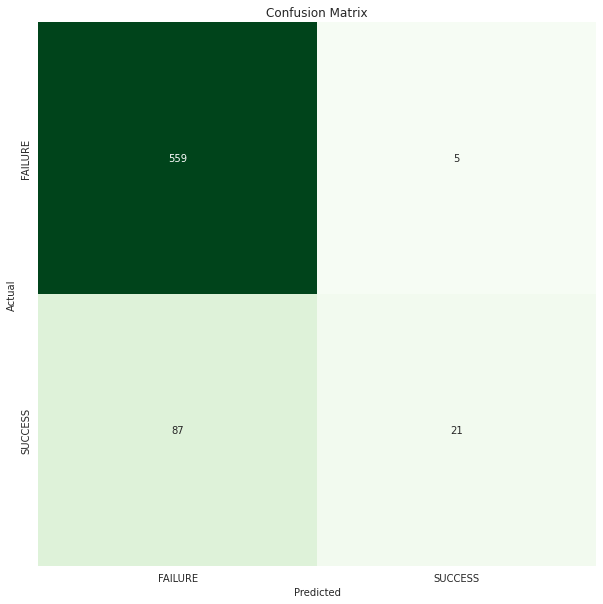

In [ ]:
# Confusion Matrix & Classification Report

cm = confusion_matrix(y_test, y_pred)
clr = classification_report(y_test, y_pred, target_names=["FAILURE", "SUCCESS"])

plt.figure(figsize=(10, 10))
sns.heatmap(cm, annot=True, fmt='g', vmin=0, cmap='Greens', cbar=False)
plt.xticks(ticks=np.arange(2) + 0.5, labels=["FAILURE", "SUCCESS"])
plt.yticks(ticks=np.arange(2) + 0.5, labels=["FAILURE", "SUCCESS"])
plt.xlabel("Predicted")
plt.ylabel("Actual")
plt.title("Confusion Matrix")
plt.show()

print("Classification Report:\n----------------------\n", clr)

In [ ]:
evaluation = model.evaluate(X_test, y_test, verbose=0)
optimizer_results('AdaGrad', X_test, y_test)

,Optimizer,Loss,Accuracy,AUC
0,Adam,0.271121,0.888393,0.901809
1,AdaGrad,0.330672,0.863095,0.848708
2,SGD,0.000000,0.000000,0.000000
3,RMSPROP,0.000000,0.000000,0.000000


#### ***SGD Optimizer***

In [ ]:
inputs = tf.keras.Input(shape=(X_train.shape[1])) 
x = tf.keras.layers.Dense(128, activation='relu')(inputs) 
x = tf.keras.layers.Dense(128, activation='relu')(x)
outputs = tf.keras.layers.Dense(1, activation='sigmoid')(x)

model = tf.keras.Model(inputs=inputs, outputs=outputs)


model.compile(
    optimizer='sgd',
    loss='binary_crossentropy',
    metrics=[
        'accuracy',
        tf.keras.metrics.AUC(name='auc')
    ]
)

history = model.fit(
    X_train,
    y_train,
    validation_split=0.2,
    batch_size=32,
    epochs=50,
    callbacks=[
        tf.keras.callbacks.EarlyStopping(
            monitor='val_loss',
            patience=3,
            restore_best_weights=True
        )
    ]
)

Epoch 1/50
40/40 [==============================] - 1s 10ms/step - loss: 0.5820 - accuracy: 0.7663 - auc: 0.4195 - val_loss: 0.5423 - val_accuracy: 0.8503 - val_auc: 0.3087
Epoch 2/50
40/40 [==============================] - 0s 3ms/step - loss: 0.4657 - accuracy: 0.8573 - auc: 0.4411 - val_loss: 0.4963 - val_accuracy: 0.8503 - val_auc: 0.4007
Epoch 3/50
40/40 [==============================] - 0s 3ms/step - loss: 0.4276 - accuracy: 0.8573 - auc: 0.5471 - val_loss: 0.4648 - val_accuracy: 0.8503 - val_auc: 0.5558
Epoch 4/50
40/40 [==============================] - 0s 3ms/step - loss: 0.4030 - accuracy: 0.8573 - auc: 0.6350 - val_loss: 0.4447 - val_accuracy: 0.8503 - val_auc: 0.6575
Epoch 5/50
40/40 [==============================] - 0s 4ms/step - loss: 0.3852 - accuracy: 0.8589 - auc: 0.6875 - val_loss: 0.4241 - val_accuracy: 0.8535 - val_auc: 0.7364
Epoch 6/50
40/40 [==============================] - 0s 3ms/step - loss: 0.3695 - accuracy: 0.8628 - auc: 0.7348 - val_loss: 0.4092 - val_ac

In [ ]:
# Predict some values
y_pred = model.predict(X_test)

y_pred = np.array(y_pred >= 0.5, dtype=np.int)

Classification Report:
----------------------
               precision    recall  f1-score   support

     FAILURE       0.90      0.97      0.94       564
     SUCCESS       0.75      0.46      0.57       108

    accuracy                           0.89       672
   macro avg       0.83      0.72      0.75       672
weighted avg       0.88      0.89      0.88       672



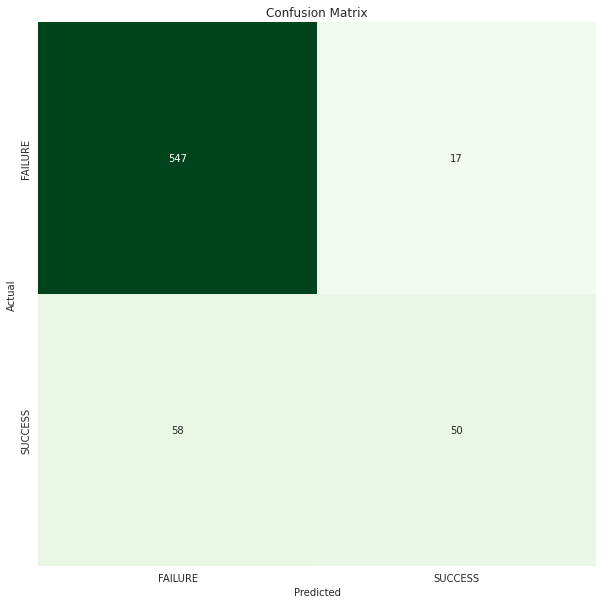

In [ ]:
# Confusion Matrix & Classification Report

cm = confusion_matrix(y_test, y_pred)
clr = classification_report(y_test, y_pred, target_names=["FAILURE", "SUCCESS"])

plt.figure(figsize=(10, 10))
sns.heatmap(cm, annot=True, fmt='g', vmin=0, cmap='Greens', cbar=False)
plt.xticks(ticks=np.arange(2) + 0.5, labels=["FAILURE", "SUCCESS"])
plt.yticks(ticks=np.arange(2) + 0.5, labels=["FAILURE", "SUCCESS"])
plt.xlabel("Predicted")
plt.ylabel("Actual")
plt.title("Confusion Matrix")
plt.show()

print("Classification Report:\n----------------------\n", clr)

In [ ]:
evaluation = model.evaluate(X_test, y_test, verbose=0)
optimizer_results('SGD', X_test, y_test)

,Optimizer,Loss,Accuracy,AUC
0,Adam,0.271121,0.888393,0.901809
1,AdaGrad,0.330672,0.863095,0.848708
2,SGD,0.268618,0.888393,0.899314
3,RMSPROP,0.000000,0.000000,0.000000


#### ***RMSPROP Optimizer***

In [ ]:
inputs = tf.keras.Input(shape=(X_train.shape[1])) 
x = tf.keras.layers.Dense(128, activation='relu')(inputs) 
x = tf.keras.layers.Dense(128, activation='relu')(x)
outputs = tf.keras.layers.Dense(1, activation='sigmoid')(x)

model = tf.keras.Model(inputs=inputs, outputs=outputs)


model.compile(
    optimizer='rmsprop',
    loss='binary_crossentropy',
    metrics=[
        'accuracy',
        tf.keras.metrics.AUC(name='auc')
    ]
)

history = model.fit(
    X_train,
    y_train,
    validation_split=0.2,
    batch_size=32,
    epochs=50,
    callbacks=[
        tf.keras.callbacks.EarlyStopping(
            monitor='val_loss',
            patience=3,
            restore_best_weights=True
        )
    ]
)

Epoch 1/50
40/40 [==============================] - 1s 11ms/step - loss: 0.3793 - accuracy: 0.8668 - auc: 0.6784 - val_loss: 0.3275 - val_accuracy: 0.8790 - val_auc: 0.8424
Epoch 2/50
40/40 [==============================] - 0s 3ms/step - loss: 0.2782 - accuracy: 0.8844 - auc: 0.8804 - val_loss: 0.2990 - val_accuracy: 0.8949 - val_auc: 0.8760
Epoch 3/50
40/40 [==============================] - 0s 3ms/step - loss: 0.2428 - accuracy: 0.8995 - auc: 0.9105 - val_loss: 0.2894 - val_accuracy: 0.8917 - val_auc: 0.8752
Epoch 4/50
40/40 [==============================] - 0s 3ms/step - loss: 0.2236 - accuracy: 0.9027 - auc: 0.9283 - val_loss: 0.2775 - val_accuracy: 0.8981 - val_auc: 0.8926
Epoch 5/50
40/40 [==============================] - 0s 3ms/step - loss: 0.2092 - accuracy: 0.9131 - auc: 0.9374 - val_loss: 0.2910 - val_accuracy: 0.8949 - val_auc: 0.8952
Epoch 6/50
40/40 [==============================] - 0s 4ms/step - loss: 0.1917 - accuracy: 0.9203 - auc: 0.9498 - val_loss: 0.2890 - val_ac

In [ ]:
# Predict some values
y_pred = model.predict(X_test)

y_pred = np.array(y_pred >= 0.5, dtype=np.int)

Classification Report:
----------------------
               precision    recall  f1-score   support

     FAILURE       0.92      0.95      0.94       564
     SUCCESS       0.70      0.56      0.63       108

    accuracy                           0.89       672
   macro avg       0.81      0.76      0.78       672
weighted avg       0.88      0.89      0.89       672



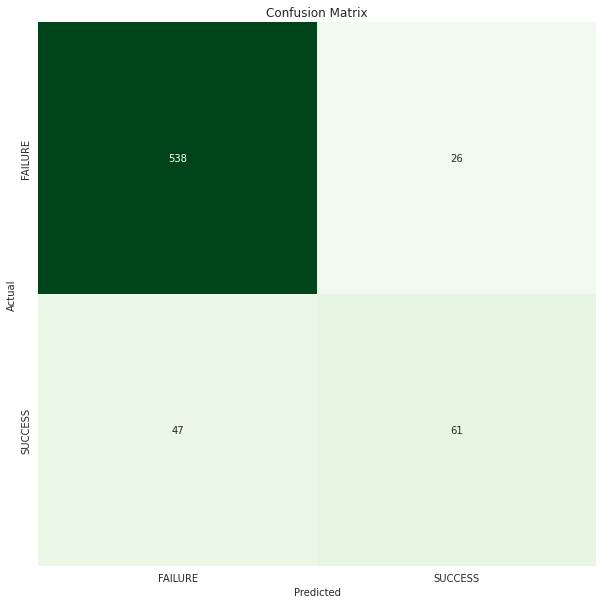

In [ ]:
# Confusion Matrix & Classification Report

cm = confusion_matrix(y_test, y_pred)
clr = classification_report(y_test, y_pred, target_names=["FAILURE", "SUCCESS"])

plt.figure(figsize=(10, 10))
sns.heatmap(cm, annot=True, fmt='g', vmin=0, cmap='Greens', cbar=False)
plt.xticks(ticks=np.arange(2) + 0.5, labels=["FAILURE", "SUCCESS"])
plt.yticks(ticks=np.arange(2) + 0.5, labels=["FAILURE", "SUCCESS"])
plt.xlabel("Predicted")
plt.ylabel("Actual")
plt.title("Confusion Matrix")
plt.show()

print("Classification Report:\n----------------------\n", clr)

In [ ]:
evaluation = model.evaluate(X_test, y_test, verbose=0)
optimizer_results('RMSPROP', X_test, y_test)

,Optimizer,Loss,Accuracy,AUC
0,Adam,0.271121,0.888393,0.901809
1,AdaGrad,0.330672,0.863095,0.848708
2,SGD,0.268618,0.888393,0.899314
3,RMSPROP,0.263100,0.891369,0.910724


## **Conclusion**

- We recommend using neural networks to predict campaign success because it performed better at predicting the outcome accurately compared to decision trees and random forests.

- The performance of different neural network optimizers varied minimally and therefore it is not clear which optimizer was best in predicting the outcome